<a href="https://colab.research.google.com/github/JonHaz/Firebase-Product-Metrics/blob/main/Frame_Differencing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Youtube video extract

In [ ]:
def extract_images_from_video(video, folder=None, delay=30, name="file", max_images=20, silent=False):    
    vidcap = cv2.VideoCapture(video)
    count = 0
    num_images = 0
    if not folder:
        folder = os.getcwd()
    label = max_label(name, folder)
    success = True
    fps = int(vidcap.get(cv2.CAP_PROP_FPS))
    
    while success and num_images < max_images:
        success, image = vidcap.read()
        num_images += 1
        label += 1
        file_name = name + "_" + str(label) + ".jpg"
        path = os.path.join(folder, file_name)
        cv2.imwrite(path, image)
        if cv2.imread(path) is None:
            os.remove(path)
        else:
            if not silent:
                print(f'Image successfully written at {path}')
        count += delay*fps
        vidcap.set(1, count)

#Frame Differencing

In [12]:
import os

file_path = '/content/1084692_027fc0e8-68c5-4e87-b9b4-d99b6a18b277_databeta_38_1650580.mp4'
consecutive_frames = 15
directory = '/content/drive/MyDrive/Snap One/Frame Differencing/frames'

os.chdir(directory)

from google.colab.patches import cv2_imshow
"""cv2.imshow() is disabled in Colab, because it causes Jupyter sessions
to crash; see https://github.com/jupyter/notebook/issues/3935.
As a substitution, consider using
  from google.colab.patches import cv2_imshow"""

'cv2.imshow() is disabled in Colab, because it causes Jupyter sessions\nto crash; see https://github.com/jupyter/notebook/issues/3935.\nAs a substitution, consider using\n  from google.colab.patches import cv2_imshow'

##Count Frames in video

In [13]:
import cv2

cap = cv2.VideoCapture(file_path)
length = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print( f"The original video has {length} frames")

The original video has 313 frames


##Get_background Function

In [14]:
import numpy as np
import cv2
def get_background(file_path):
    cap = cv2.VideoCapture(file_path)
    # we will randomly select 50 frames for the calculating the median
    frame_indices = cap.get(cv2.CAP_PROP_FRAME_COUNT) * np.random.uniform(size=50)
    # we will store the frames in array
    frames = []
    for idx in frame_indices:
        # set the frame id to read that particular frame
        cap.set(cv2.CAP_PROP_POS_FRAMES, idx)
        ret, frame = cap.read()
        frames.append(frame)
    # calculate the median
    median_frame = np.median(frames, axis=0).astype(np.uint8)
    return median_frame

##Detection Function

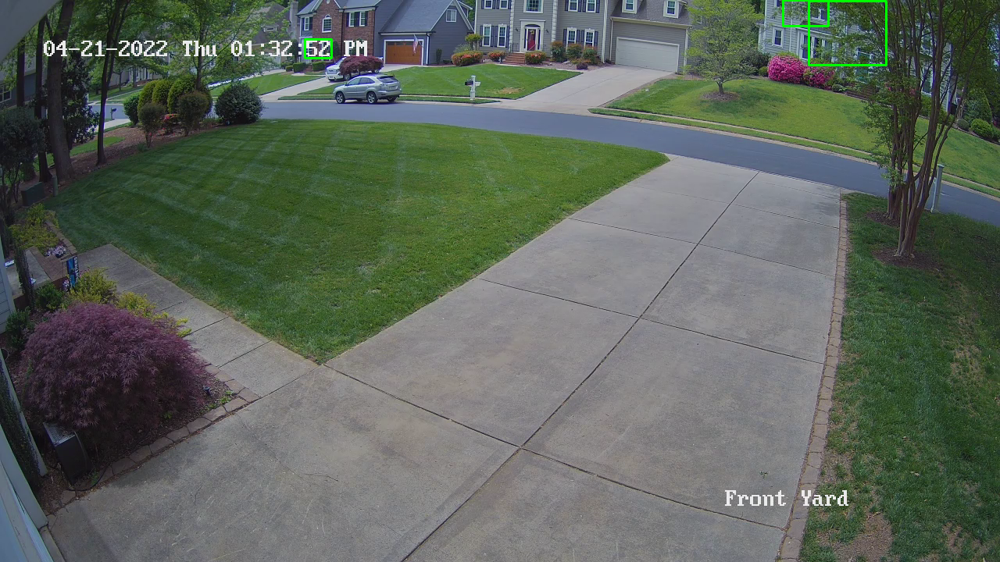

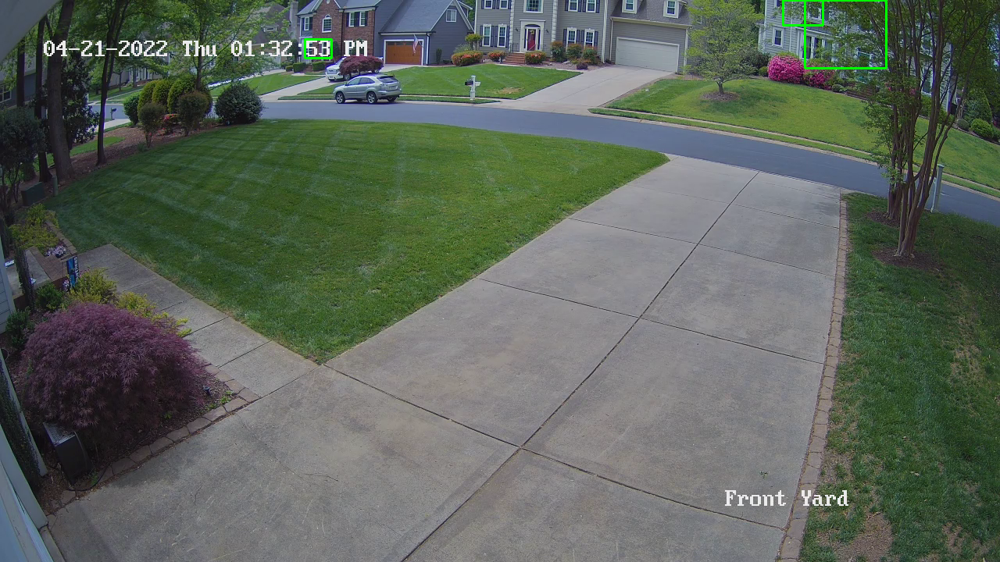

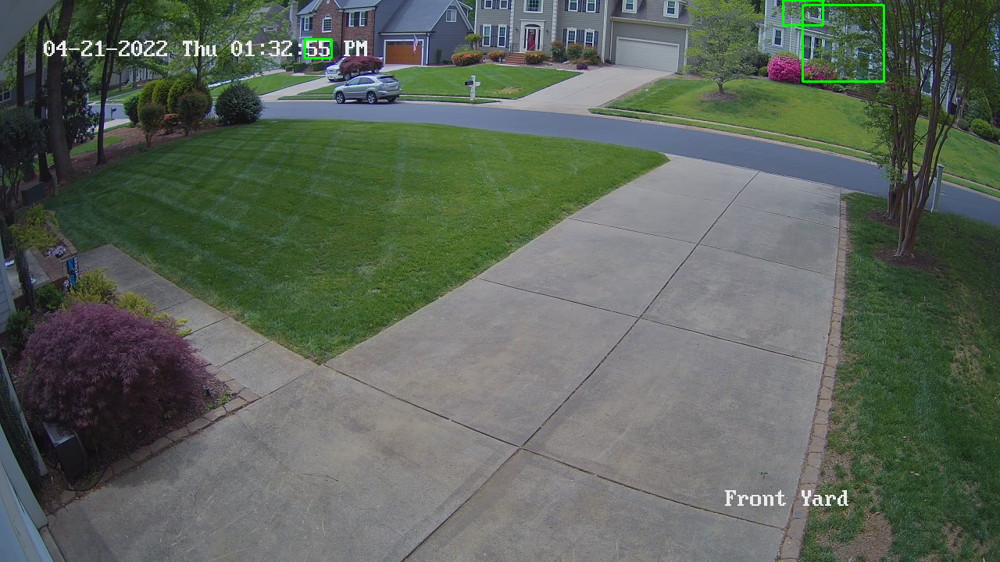

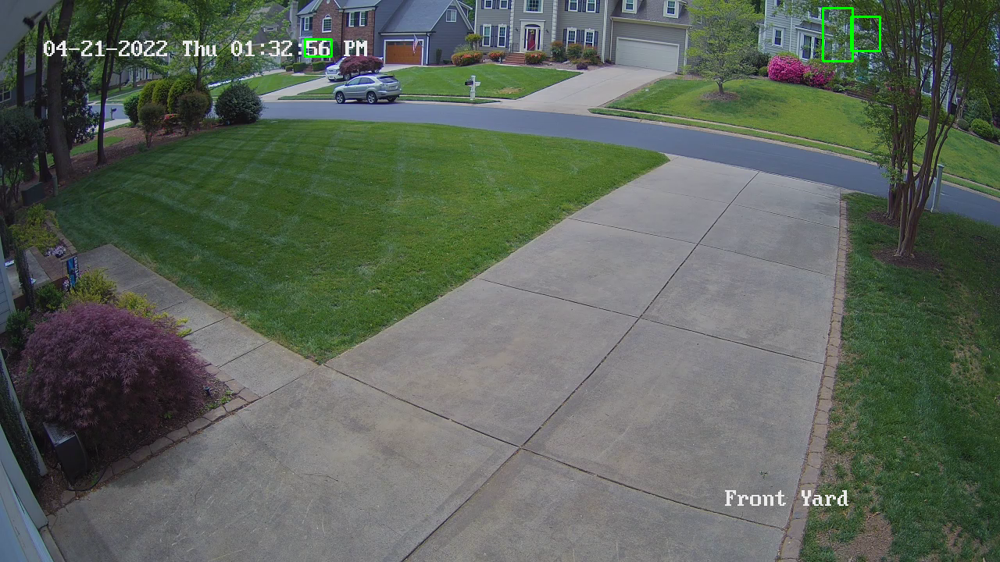

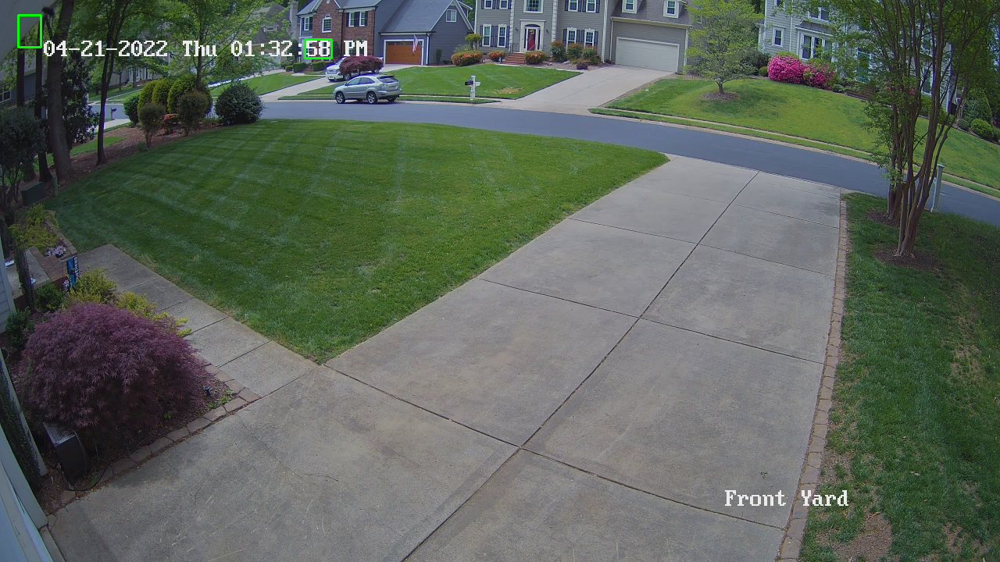

...

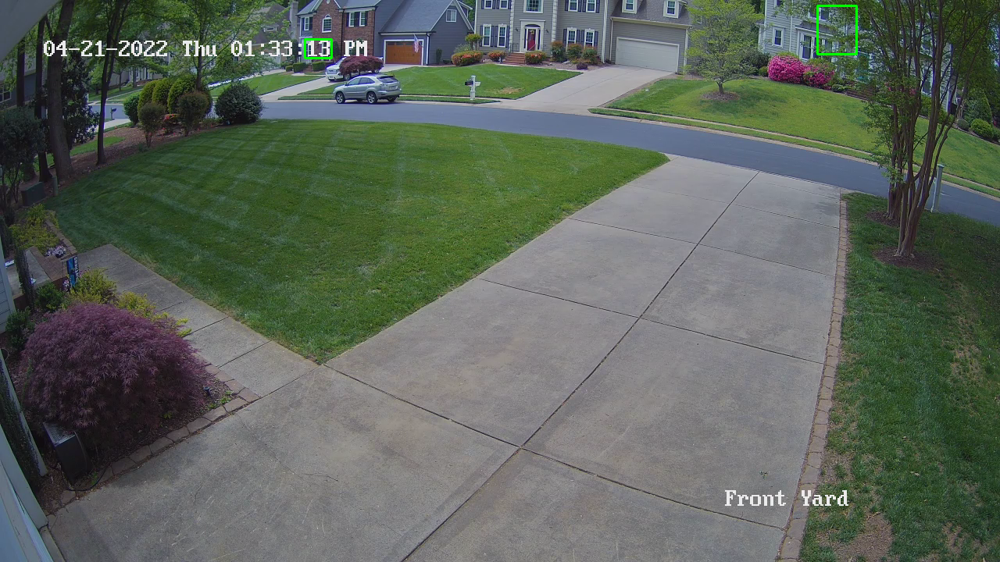

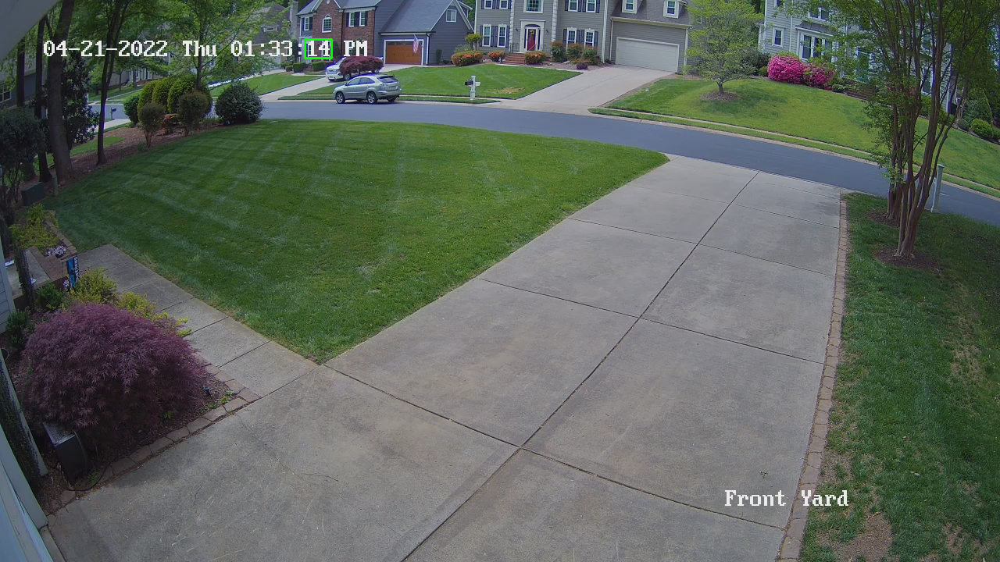

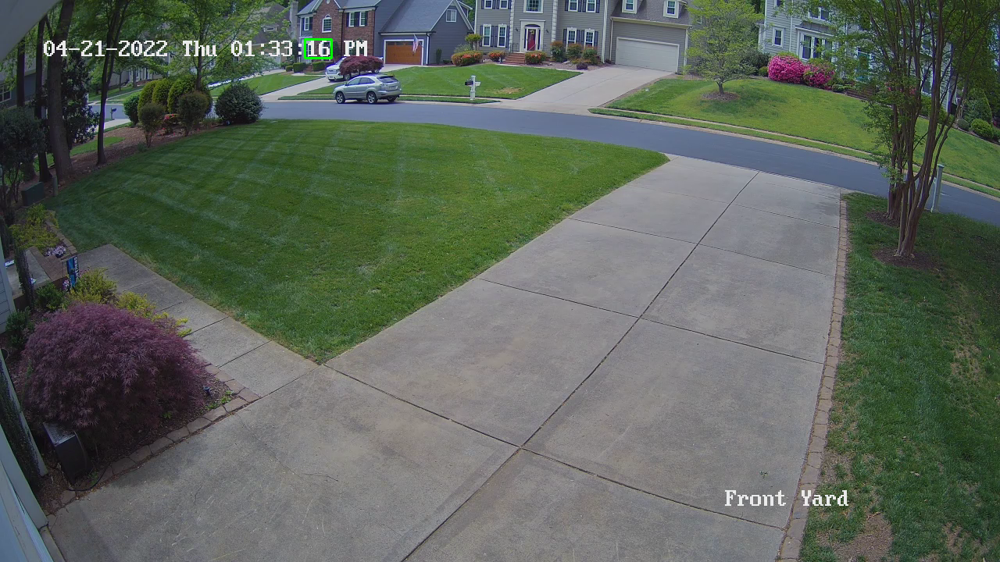

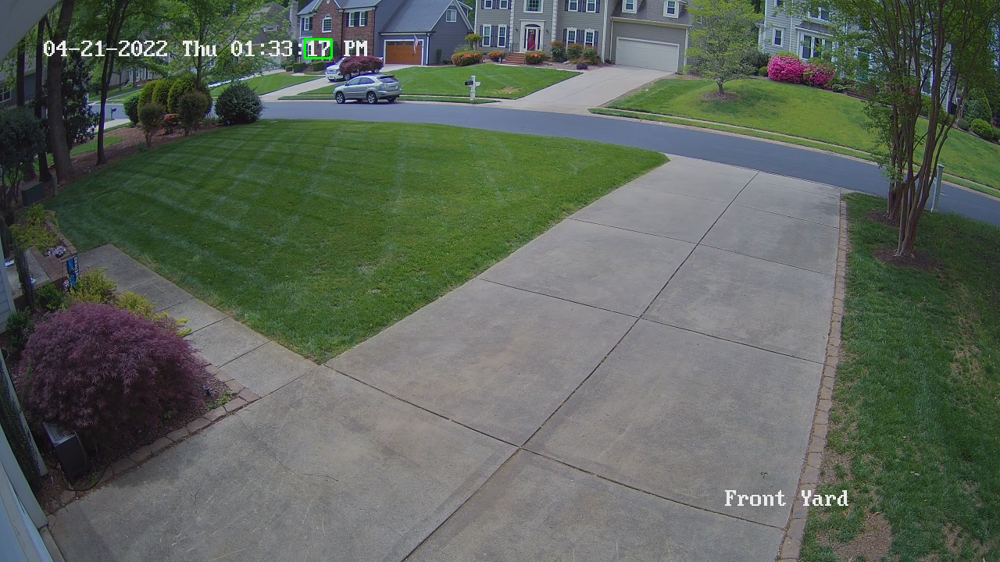

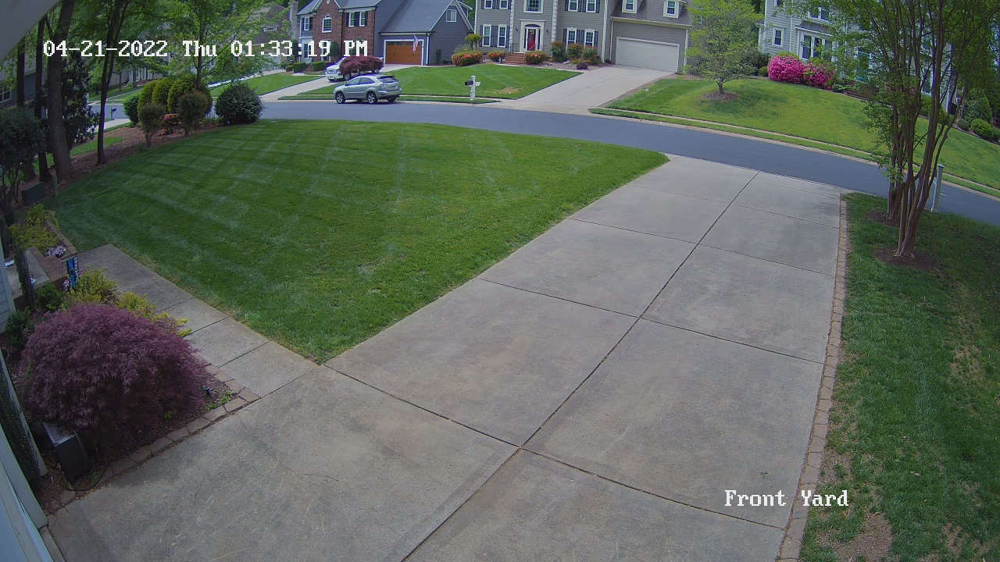

In [15]:
import cv2
import matplotlib.pyplot as plt
from matplotlib.pyplot import savefig


cap = cv2.VideoCapture(file_path)
# get the video frame height and width
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
save_name = f"outputs/{file_path.split('/')[-1]}"
# define codec and create VideoWriter object
out = cv2.VideoWriter(
    save_name,
    cv2.VideoWriter_fourcc(*'mp4v'), 10,
    (frame_width, frame_height)
)
# get the background model
background = get_background(file_path)
# convert the background model to grayscale format
background = cv2.cvtColor(background, cv2.COLOR_BGR2GRAY)
counter = 0

frame_count = 0

new_frame_count = 0

consecutive_frame = consecutive_frames
while (cap.isOpened()):
    ret, frame = cap.read()
    if ret == True:
        frame_count += 1
        orig_frame = frame.copy()
        # IMPORTANT STEP: convert the frame to grayscale first
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        if frame_count % consecutive_frame == 0 or frame_count == 1:
            frame_diff_list = []
        # find the difference between current frame and base frame
        frame_diff = cv2.absdiff(gray, background)
        # thresholding to convert the frame to binary
        ret, thres = cv2.threshold(frame_diff, 50, 255, cv2.THRESH_BINARY)
        # dilate the frame a bit to get some more white area...
        # ... makes the detection of contours a bit easier
        dilate_frame = cv2.dilate(thres, None, iterations=2)
        # append the final result into the `frame_diff_list`
        frame_diff_list.append(dilate_frame)
        # if we have reached `consecutive_frame` number of frames
        if len(frame_diff_list) == consecutive_frame:
            # add all the frames in the `frame_diff_list`
            sum_frames = sum(frame_diff_list)
            # find the contours around the white segmented areas
            contours, hierarchy = cv2.findContours(sum_frames, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            # draw the contours, not strictly necessary
            for i, cnt in enumerate(contours):
                # count frame with motion
                cv2.imwrite('Frame'+str(new_frame_count)+'.jpg', frame)
                new_frame_count += 1
                
                cv2.drawContours(frame, contours, i, (0, 0, 255), 3)
            for contour in contours:
                # continue through the loop if contour area is less than 500...
                # ... helps in removing noise detection
                if cv2.contourArea(contour) < 500:
                    continue
                
                # get the xmin, ymin, width, and height coordinates from the contours
                (x, y, w, h) = cv2.boundingRect(contour)
                # draw the bounding boxes
                cv2.rectangle(orig_frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

            #cv2.imshow('Detected Objects', orig_frame)
            cv2_imshow(orig_frame)
            out.write(orig_frame)
            
            if cv2.waitKey(100) & 0xFF == ord('q'):
                break
    else:
      
      break
cap.release()
cv2.destroyAllWindows()


In [16]:
print("After saving image:")  
print(os.listdir(directory))
  
print('Successfully saved')

After saving image:
['Frame866.jpg', 'Frame867.jpg', 'Frame868.jpg', 'Frame869.jpg', 'Frame870.jpg', 'Frame871.jpg', 'Frame872.jpg', 'Frame873.jpg', 'Frame874.jpg', 'Frame875.jpg', 'Frame876.jpg', 'Frame877.jpg', 'Frame878.jpg', 'Frame879.jpg', 'Frame880.jpg', 'Frame881.jpg', 'Frame882.jpg', 'Frame883.jpg', 'Frame884.jpg', 'Frame885.jpg', 'Frame886.jpg', 'Frame887.jpg', 'Frame888.jpg', 'Frame889.jpg', 'Frame890.jpg', 'Frame891.jpg', 'Frame892.jpg', 'Frame893.jpg', 'Frame894.jpg', 'Frame895.jpg', 'Frame896.jpg', 'Frame897.jpg', 'Frame898.jpg', 'Frame899.jpg', 'Frame900.jpg', 'Frame901.jpg', 'Frame902.jpg', 'Frame903.jpg', 'Frame904.jpg', 'Frame905.jpg', 'Frame906.jpg', 'Frame907.jpg', 'Frame908.jpg', 'Frame909.jpg', 'Frame910.jpg', 'Frame911.jpg', 'Frame912.jpg', 'Frame913.jpg', 'Frame914.jpg', 'Frame915.jpg', 'Frame916.jpg', 'Frame917.jpg', 'Frame918.jpg', 'Frame919.jpg', 'Frame920.jpg', 'Frame921.jpg', 'Frame922.jpg', 'Frame923.jpg', 'Frame924.jpg', 'Frame925.jpg', 'Frame926.jpg', 'Fr

##Result of Frame differencing

In [17]:
print(f"{new_frame_count} frames where extracted")

print(f"Frame Differencing has resulted in a {round(frame_count/new_frame_count)} fold reduction in the number of frames")

1014 frames where extracted
Frame Differencing has resulted in a 0 fold reduction in the number of frames


## Confirmation of saved frames w/o bounding boxes

In [18]:
print("After saving image:")  
print(os.listdir(directory))
  
print('Successfully saved')

After saving image:
['Frame866.jpg', 'Frame867.jpg', 'Frame868.jpg', 'Frame869.jpg', 'Frame870.jpg', 'Frame871.jpg', 'Frame872.jpg', 'Frame873.jpg', 'Frame874.jpg', 'Frame875.jpg', 'Frame876.jpg', 'Frame877.jpg', 'Frame878.jpg', 'Frame879.jpg', 'Frame880.jpg', 'Frame881.jpg', 'Frame882.jpg', 'Frame883.jpg', 'Frame884.jpg', 'Frame885.jpg', 'Frame886.jpg', 'Frame887.jpg', 'Frame888.jpg', 'Frame889.jpg', 'Frame890.jpg', 'Frame891.jpg', 'Frame892.jpg', 'Frame893.jpg', 'Frame894.jpg', 'Frame895.jpg', 'Frame896.jpg', 'Frame897.jpg', 'Frame898.jpg', 'Frame899.jpg', 'Frame900.jpg', 'Frame901.jpg', 'Frame902.jpg', 'Frame903.jpg', 'Frame904.jpg', 'Frame905.jpg', 'Frame906.jpg', 'Frame907.jpg', 'Frame908.jpg', 'Frame909.jpg', 'Frame910.jpg', 'Frame911.jpg', 'Frame912.jpg', 'Frame913.jpg', 'Frame914.jpg', 'Frame915.jpg', 'Frame916.jpg', 'Frame917.jpg', 'Frame918.jpg', 'Frame919.jpg', 'Frame920.jpg', 'Frame921.jpg', 'Frame922.jpg', 'Frame923.jpg', 'Frame924.jpg', 'Frame925.jpg', 'Frame926.jpg', 'Fr

##Saving extracted images with motion

In [19]:
import os
print( os.getcwd() )
print( os.listdir() )

/content/drive/MyDrive/Snap One/Frame Differencing/frames
['Frame866.jpg', 'Frame867.jpg', 'Frame868.jpg', 'Frame869.jpg', 'Frame870.jpg', 'Frame871.jpg', 'Frame872.jpg', 'Frame873.jpg', 'Frame874.jpg', 'Frame875.jpg', 'Frame876.jpg', 'Frame877.jpg', 'Frame878.jpg', 'Frame879.jpg', 'Frame880.jpg', 'Frame881.jpg', 'Frame882.jpg', 'Frame883.jpg', 'Frame884.jpg', 'Frame885.jpg', 'Frame886.jpg', 'Frame887.jpg', 'Frame888.jpg', 'Frame889.jpg', 'Frame890.jpg', 'Frame891.jpg', 'Frame892.jpg', 'Frame893.jpg', 'Frame894.jpg', 'Frame895.jpg', 'Frame896.jpg', 'Frame897.jpg', 'Frame898.jpg', 'Frame899.jpg', 'Frame900.jpg', 'Frame901.jpg', 'Frame902.jpg', 'Frame903.jpg', 'Frame904.jpg', 'Frame905.jpg', 'Frame906.jpg', 'Frame907.jpg', 'Frame908.jpg', 'Frame909.jpg', 'Frame910.jpg', 'Frame911.jpg', 'Frame912.jpg', 'Frame913.jpg', 'Frame914.jpg', 'Frame915.jpg', 'Frame916.jpg', 'Frame917.jpg', 'Frame918.jpg', 'Frame919.jpg', 'Frame920.jpg', 'Frame921.jpg', 'Frame922.jpg', 'Frame923.jpg', 'Frame924.jpg